<a href="https://colab.research.google.com/github/sims-kale/brainFMRI-2-image/blob/main/Assessment_template.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Deep neural networks and learning systems - Assessment**

*Part I: Reading and exploring the data*

In [15]:
import torch
from torch import nn
import matplotlib.pyplot as plt
import os
import numpy as np
from PIL import Image

In [16]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Setting up the dataset**

In [17]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)
root_dir = '/content/drive/MyDrive/DNNLS_Assessment/algonauts_2023_tutorial_data' # Modify this to your local drive

Mounted at /content/drive/


The following functions can be used to load the FMRI data from a given subject, load activity from a given region of interest or loading the corresponding image.

In [18]:
# Loads all the fmri data associated to a given subject

# def load_fmri_of_subject( subj, hemisphere, directory = root_dir ):
#   # subj = 1 # Subject
#   hemisphere = 'left' # Which side of the brain
#   # Listing directory
#   subj = format(subj, '02')
#   data_dir = os.path.join(directory, 'subj' + subj) # subj01
#   fmri_dir = os.path.join(data_dir, 'training_split', 'training_fmri') # Location the brain activation
#   # Here we load the data
#   if hemisphere == 'left':
#     brain_activity = np.load(os.path.join(fmri_dir, 'lh_training_fmri.npy'))
#   else:
#     brain_activity = np.load(os.path.join(fmri_dir, 'rh_training_fmri.npy'))
#   return brain_activity

# Loads the data associated to a specific part of the brain (Some will be empty, it varies by subject)
def load_fmri_region_of_interest( subj, roi, hemisphere, directory = root_dir):
  subj = format(subj, '02')
  # print(subj)
  data_dir = os.path.join(directory, 'subj' + subj) # subj01
  # print(data_dir)
    # Define the ROI class based on the selected ROI
  roi_class = None
  if roi in ["V1v", "V1d", "V2v", "V2d", "V3v", "V3d", "hV4"]:
      roi_class = 'prf-visualrois'
  elif roi in ["EBA", "FBA-1", "FBA-2", "mTL-bodies"]:
      roi_class = 'floc-bodies'
  elif roi in ["OFA", "FFA-1", "FFA-2", "mTL-faces", "aTL-faces"]:
      roi_class = 'floc-faces'
  elif roi in ["OPA", "PPA", "RSC"]:
      roi_class = 'floc-places'
  elif roi in ["OWFA", "VWFA-1", "VWFA-2", "mfs-words", "mTL-words"]:
      roi_class = 'floc-words'
  elif roi in ["early", "midventral", "midlateral", "midparietal", "ventral", "lateral", "parietal"]:
      roi_class = 'streams'

  # Loading the roi masks (To locate the activations of a given region)
  roi_class_dir = os.path.join(data_dir, 'roi_masks',
      f"{hemisphere[0]}h.{roi_class}_challenge_space.npy")
  roi_map_dir = os.path.join(data_dir, 'roi_masks',
      f"mapping_{roi_class}.npy")
  # print(f"roi_map: {roi_map_dir}")
  roi_class_idx = np.load(roi_class_dir)
  roi_map = np.load(roi_map_dir, allow_pickle=True).item()
  roi_mapping = list(roi_map.keys())[list(roi_map.values()).index(roi)]
  challenge_roi = np.asarray(roi_class_idx == roi_mapping, dtype=int)

  # Selection the appropriate data
  fmri_dir = os.path.join(data_dir, 'training_split', 'training_fmri') # Location the brain activation
  # Here we load the data
  if hemisphere == 'left':
    brain_activity = np.load(os.path.join(fmri_dir, 'lh_training_fmri.npy'))
  else:
    brain_activity = np.load(os.path.join(fmri_dir, 'rh_training_fmri.npy'))

  fmri_roi_data = brain_activity[:,np.where(challenge_roi)[0]]
  print(f"fmri_roi_data.shape: {fmri_roi_data}")

  return fmri_roi_data

# Load a particular image from a subject
def load_image_subject( subj, img, directory = root_dir):
  subj = format(subj, '02')
  data_dir = os.path.join(directory, 'subj' + subj) # subj01
  train_img_dir  = os.path.join(data_dir, 'training_split', 'training_images')
  test_img_dir  = os.path.join(data_dir, 'test_split', 'test_images')
  train_img_list = os.listdir(train_img_dir)
  train_img_list.sort()
  test_img_list = os.listdir(test_img_dir)
  test_img_list.sort()

  img_dir = os.path.join(train_img_dir, train_img_list[img])
  # print(f"img_dir: {img_dir}")
  train_img = Image.open(img_dir).convert('RGB') # Image library (PIL)
  # plt.imshow(train_img)
  # plt.show()
  return train_img



**Explore the brain responses**

First, start by getting familiar with the brain activations. What is their range? How do they change for different images?

fmri_roi_data.shape: [[-1.1978967e+00 -3.6346653e-01 -2.5069547e-01 ... -6.3155103e-01
   6.3117512e-02 -2.6468334e-01]
 [-3.1303048e-01  9.5700639e-01 -2.2253151e-01 ...  6.5957463e-01
   2.4391200e-01  6.4392221e-01]
 [-3.2403934e-01 -7.7118433e-01 -1.4521885e+00 ... -7.7181566e-01
  -1.8628736e-01 -7.5885379e-01]
 ...
 [ 3.0036092e-01  2.1192510e-01 -8.8012743e-01 ... -1.9732107e-01
  -6.8201832e-02  3.5286158e-01]
 [-6.6955805e-01  1.8425088e-01 -6.9083124e-01 ... -4.3016210e-01
  -1.9560716e-01 -3.3048448e-01]
 [-8.0841213e-01 -1.7046640e-04  5.5396807e-01 ...  8.5623302e-02
   2.4076644e-01  2.9368699e-02]]
(9841, 2837)


<BarContainer object of 2 artists>

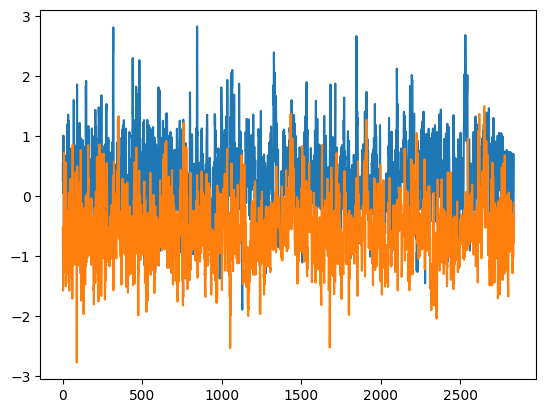

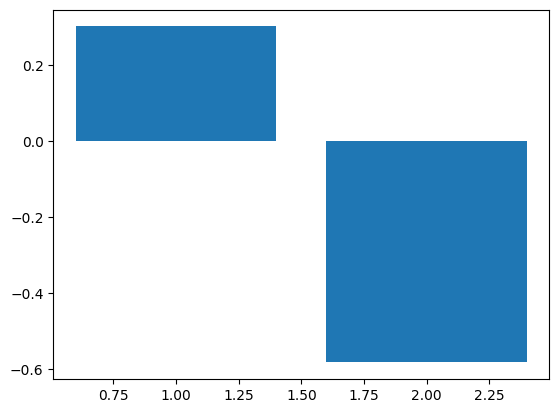

In [19]:
brain_activity = load_fmri_region_of_interest( subj = 1, roi ='EBA', hemisphere = 'left') # Images x activations

print(brain_activity.shape) # Images x brain activty
img1 = 10
img2 = 560
plt.plot(brain_activity[img1, :]) # Normalized (Z-Score)
plt.plot(brain_activity[img2, :])

plt.figure()
activation1 = np.mean(brain_activity[img1, :])
activation2 = np.mean(brain_activity[img2, :])
plt.bar((1, 2), (activation1, activation2))

**Selecting a particular ROIs**

You can be more accurate by selecting, from the total number of activations (voxels), those belonging to a particular regions. Those activations correspond to a particular location in the brain that has some functions significance:


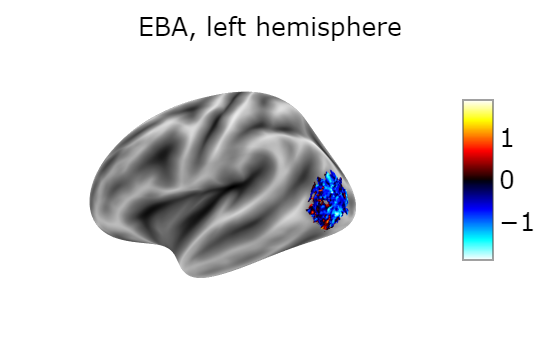:

In [20]:
roi = "V1v"
fmri_roi_data = load_fmri_region_of_interest( subj = 1, roi = roi, hemisphere = 'left' ) # Images x roi_data
print(fmri_roi_data.shape)

fmri_roi_data.shape: [[-0.4051893  -0.13202126 -0.15646861 ... -0.30014917  0.03346608
   0.32592234]
 [ 0.73441166 -0.07985345  0.09033004 ...  0.79889697  0.8275901
   0.08024099]
 [ 0.23203665  0.272405   -1.000061   ...  0.8203399   0.11802689
   0.08885956]
 ...
 [ 0.40565196  1.4531507  -0.20654283 ... -0.8937565  -1.1738853
  -0.91794443]
 [-0.2722196   0.37265083 -0.31522635 ... -0.41355157 -0.5483944
  -0.24841239]
 [ 0.2153385  -1.1112833  -1.0181917  ... -1.5771451  -0.7339266
  -1.574942  ]]
(9841, 710)


## **Loading the images and FMRI data in batch**

fmri_roi_data.shape: [[-1.1978967e+00 -3.6346653e-01 -2.5069547e-01 ... -6.3155103e-01
   6.3117512e-02 -2.6468334e-01]
 [-3.1303048e-01  9.5700639e-01 -2.2253151e-01 ...  6.5957463e-01
   2.4391200e-01  6.4392221e-01]
 [-3.2403934e-01 -7.7118433e-01 -1.4521885e+00 ... -7.7181566e-01
  -1.8628736e-01 -7.5885379e-01]
 ...
 [ 3.0036092e-01  2.1192510e-01 -8.8012743e-01 ... -1.9732107e-01
  -6.8201832e-02  3.5286158e-01]
 [-6.6955805e-01  1.8425088e-01 -6.9083124e-01 ... -4.3016210e-01
  -1.9560716e-01 -3.3048448e-01]
 [-8.0841213e-01 -1.7046640e-04  5.5396807e-01 ...  8.5623302e-02
   2.4076644e-01  2.9368699e-02]]


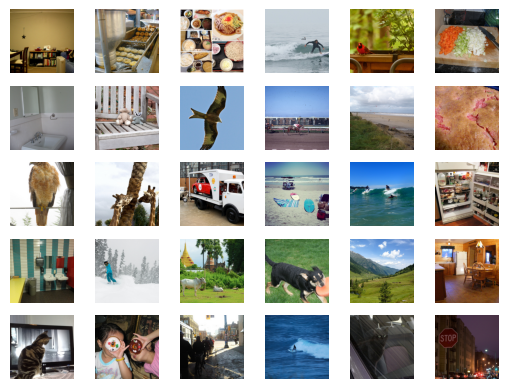

In [21]:
import math
num_samples = 30
subj = 1
roi = 'EBA'
hemisphere = 'left'


# Load all fMRI data from ROI
fmri_data = load_fmri_region_of_interest(subj, roi, hemisphere)
fmri_batch = fmri_data[:num_samples]  # shape: (samples, num_voxels)

image_batch = [load_image_subject(1, i) for i in range(num_samples)]

num_rows = int(math.sqrt(len(image_batch)))
num_cols = int(math.ceil(len(image_batch) / num_rows))
for i, image in enumerate(image_batch):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.imshow(image, cmap="gray")
    plt.axis("off")

plt.show()


In [22]:
# !pip install clip==0.2.0
# !pip uninstall -y clip
!pip install git+https://github.com/openai/CLIP.git


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-1x1qaxj9
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-1x1qaxj9
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done


***Generate CLIP Embeddings***

In [9]:
!pip install transformers torchvision


In [23]:
from transformers import BlipProcessor, BlipForConditionalGeneration
from PIL import Image
import torch

# Load BLIP model and processor
device = "cuda" if torch.cuda.is_available() else "cpu"
blip_processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
blip_model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base").to(device)
generated_captions = []

for img in image_batch:
    inputs = blip_processor(images=img, return_tensors="pt").to(device)
    with torch.no_grad():
        out = blip_model.generate(**inputs)
    caption = blip_processor.decode(out[0], skip_special_tokens=True)
    generated_captions.append(caption)

print("BLIP Captions Example:")
for i, cap in enumerate(generated_captions[:5]):
    print(f"{i+1}. {cap}")
general_prompts  = [
    "a dog", "a car","a man eating food", "a clean beach", "a crowded stadium","a crowded place","A food factory", "a photo of a skin disease", "a photo of a animal",
    "a mountain", "a close-up face", "a group of birds", "a food dish with rice", "a photo of a cat",
    "a plate of salad", "a person sitting in a cafe", "a baby with toys", "a flower image", "a house", "a apartment","a photo of a bathroom",
]

# Combine both into one list
text_content = list(set(general_prompts + generated_captions))  # remove duplicates
print(f"Total descriptions: {len(text_content)}")

BLIP Captions Example:
1. a room with a bed, desk, and a television
2. a machine that is making doughs in a kitchen
3. a col of pictures of various dishes of food
4. a person on a surf board riding a wave
5. a red bird sitting on a wooden table
Total descriptions: 51


In [27]:
import torch
from PIL import Image
import numpy as np
from transformers import CLIPProcessor, CLIPModel

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# clip_model, preprocess = clip.load("ViT-B/32", device=device)
# clip_model.eval()
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32").to(device)
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# Tokenize and encode the text simatic content
text_inputs = clip_processor(text=text_content, return_tensors="pt", padding=True).to(device)
with torch.no_grad():
    text_features = clip_model.get_text_features(**text_inputs)
    text_features = text_features / text_features.norm(dim=-1, keepdim=True)




## Function to extract CLIP embeddings for a list of images and FMRI data

In [26]:
def get_clip_embeddings(images):
    embeddings = []
    for img in images:
        # Preprocess image using HuggingFace CLIPProcessor
        inputs = clip_processor(images=img, return_tensors="pt").to(device)
        with torch.no_grad():
            outputs = clip_model.get_image_features(**inputs)
            outputs /= outputs.norm(dim=-1, keepdim=True)
        embeddings.append(outputs.squeeze(0).cpu().numpy())
    return np.array(embeddings)

# Generate CLIP embeddings for your 10 images
clip_targets = get_clip_embeddings(image_batch)

print(f"FMRI Batch Shape: {fmri_batch.shape}")
print("CLIP embeddings shape:", clip_targets.shape)  # (10, 512)

FMRI Batch Shape: (30, 2837)
CLIP embeddings shape: (30, 512)


### generate a random predicted CLIP Embedding for preliminary result using a pretrained CLIP model and Compared with real CLIP Embedding from 30 images

-------- Transformer -------

In [28]:
import torch
import torch.nn as nn
import torch.optim as optim

# Transformer-based brain-to-CLIP model
class BrainTransformer(nn.Module):
    def __init__(self, input_dim=2837, embed_dim=512, output_dim=512, num_heads=4, num_layers=3):
        super().__init__()

        self.pre_fc = nn.Sequential(
            nn.Linear(input_dim, 1024),
            nn.ReLU(),
            nn.Dropout(0.1),
            nn.Linear(1024, embed_dim)
        )

        self.pos_embedding = nn.Parameter(torch.randn(1, 1, embed_dim))

        encoder_layer = nn.TransformerEncoderLayer(
            d_model=embed_dim,
            nhead=num_heads,
            batch_first=True,
            dropout=0.1,
            activation='gelu'
        )
        self.transformer = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.output_layer = nn.Linear(embed_dim, output_dim)

    def forward(self, x):
        x = self.pre_fc(x).unsqueeze(1) + self.pos_embedding
        x = self.transformer(x)
        return self.output_layer(x.squeeze(1))


# Move data to torch tensors
fmri_tensor = torch.tensor(fmri_batch, dtype=torch.float32)
clip_tensor = torch.tensor(clip_targets, dtype=torch.float32)

# Model, loss, optimizer
model = BrainTransformer(input_dim=fmri_tensor.shape[1]).to("cuda" if torch.cuda.is_available() else "cpu")
optimizer = optim.Adam(model.parameters(), lr=1e-4)
loss_fn = nn.MSELoss()

# Move data to same device
device = next(model.parameters()).device
fmri_tensor = fmri_tensor.to(device)
clip_tensor = clip_tensor.to(device)

# Train the model
epochs = 300
for epoch in range(epochs):
    model.train()
    optimizer.zero_grad()

    outputs = model(fmri_tensor)
    loss = loss_fn(outputs, clip_tensor)

    loss.backward()
    optimizer.step()

    if epoch % 50 == 0:
        print(f"Epoch {epoch} - Loss: {loss.item():.4f}")

model.eval()
with torch.no_grad():
    predicted_clip = model(fmri_tensor).cpu().numpy()  # shape (30, 512)

Epoch 0 - Loss: 0.3385
Epoch 50 - Loss: 0.0118
Epoch 100 - Loss: 0.0094
Epoch 150 - Loss: 0.0078
Epoch 200 - Loss: 0.0066
Epoch 250 - Loss: 0.0054



===== Sample 1 =====


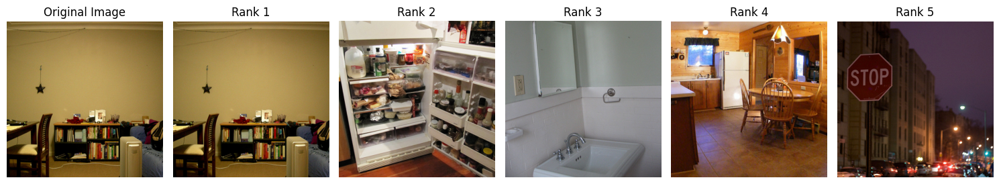

Top-5 Predicted Descriptions:
1. a apartment
2. a photo of a animal
3. a grassy hill
4. a baby with toys
5. a house
Cosine similarity to true embedding: 79.98%

===== Sample 2 =====


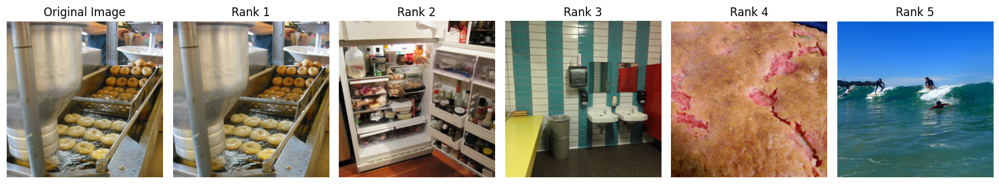

Top-5 Predicted Descriptions:
1. A food factory
2. a crowded place
3. a photo of a skin disease
4. a col of pictures of various dishes of food
5. a group of gis
Cosine similarity to true embedding: 77.21%

===== Sample 3 =====


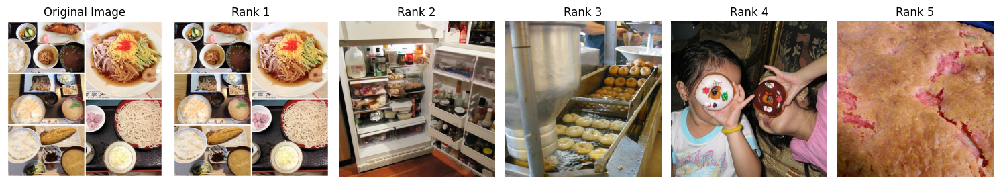

Top-5 Predicted Descriptions:
1. a col of pictures of various dishes of food
2. a food dish with rice
3. A food factory
4. a photo of a animal
5. a crowded place
Cosine similarity to true embedding: 69.78%

===== Sample 4 =====


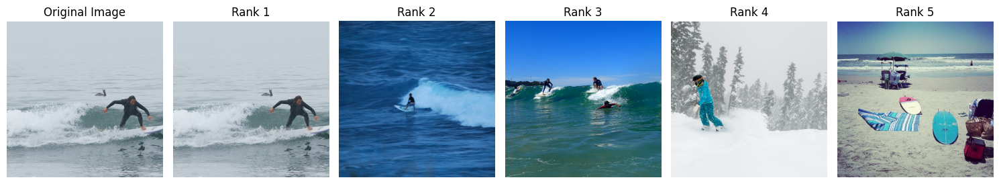

Top-5 Predicted Descriptions:
1. a person on a surf board riding a wave
2. a wave in the ocean
3. a person on a snowboard
4. a photo of a animal
5. a group of people surfing in the ocean
Cosine similarity to true embedding: 76.50%

===== Sample 5 =====


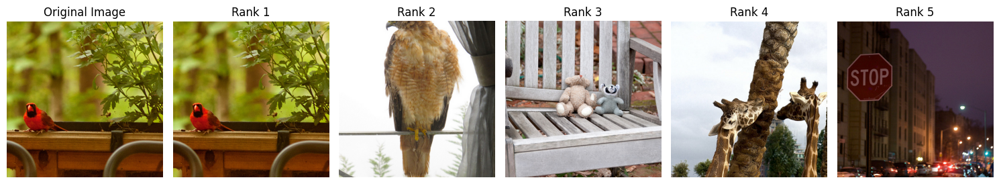

Top-5 Predicted Descriptions:
1. a red bird sitting on a wooden table
2. a photo of a animal
3. a bird sitting on a wire
4. a group of birds
5. a crowded place
Cosine similarity to true embedding: 78.50%

===== Sample 6 =====


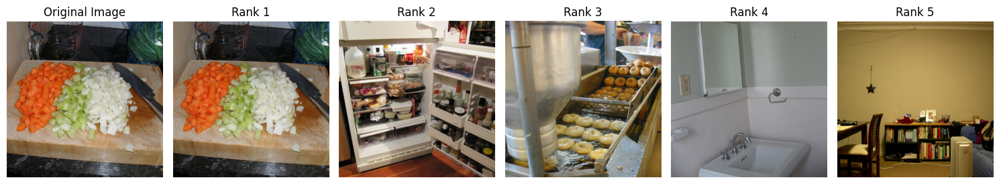

Top-5 Predicted Descriptions:
1. a refrigerator with a lot of food inside of it
2. a col of pictures of various dishes of food
3. a photo of a skin disease
4. a photo of a animal
5. a group of gis
Cosine similarity to true embedding: 73.45%

===== Sample 7 =====


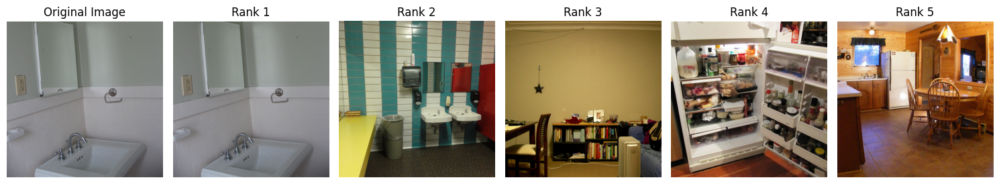

Top-5 Predicted Descriptions:
1. a white sink with a mirror above it
2. a photo of a bathroom
3. a apartment
4. a crowded place
5. A food factory
Cosine similarity to true embedding: 79.41%

===== Sample 8 =====


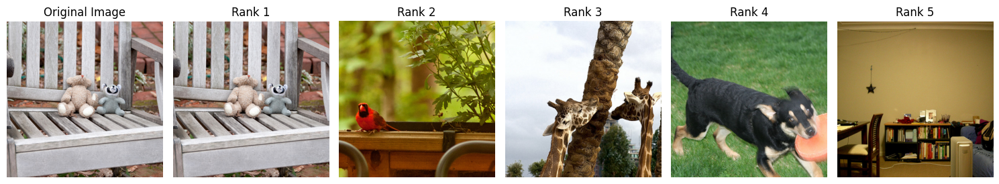

Top-5 Predicted Descriptions:
1. a teddy bear sitting on a bench with a stuffed bear
2. a crowded place
3. a photo of a animal
4. a group of birds
5. a grassy hill
Cosine similarity to true embedding: 78.97%

===== Sample 9 =====


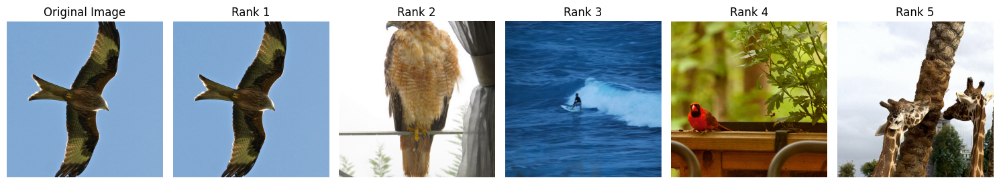

Top-5 Predicted Descriptions:
1. a photo of a animal
2. a close-up face
3. a bird flying in the sky
4. a group of birds
5. a blue sky
Cosine similarity to true embedding: 78.24%

===== Sample 10 =====


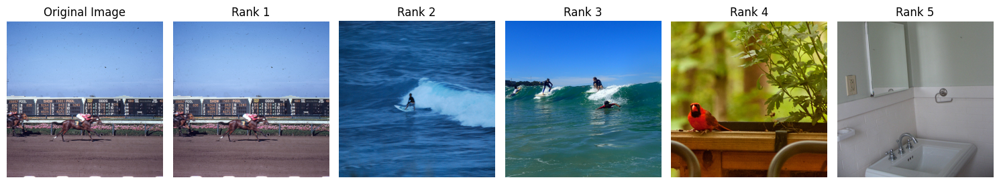

Top-5 Predicted Descriptions:
1. a photo of a animal
2. a crowded place
3. a crowded stadium
4. a group of birds
5. a grassy hill
Cosine similarity to true embedding: 73.06%

===== Sample 11 =====


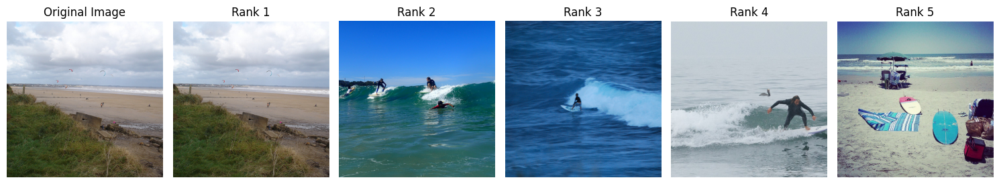

Top-5 Predicted Descriptions:
1. a grassy hill
2. a photo of a animal
3. a clean beach
4. a group of gis
5. a blue sky
Cosine similarity to true embedding: 74.59%

===== Sample 12 =====


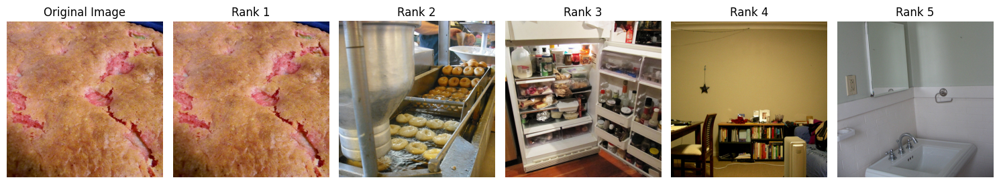

Top-5 Predicted Descriptions:
1. a photo of a skin disease
2. a photo of a animal
3. a close-up face
4. a col of pictures of various dishes of food
5. a man eating food
Cosine similarity to true embedding: 74.51%

===== Sample 13 =====


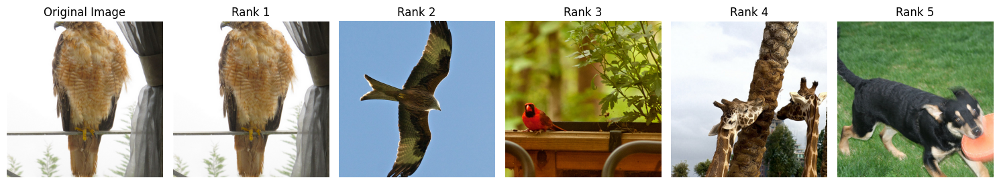

Top-5 Predicted Descriptions:
1. a photo of a animal
2. a close-up face
3. a crowded place
4. a blue sky
5. a photo of a skin disease
Cosine similarity to true embedding: 77.60%

===== Sample 14 =====


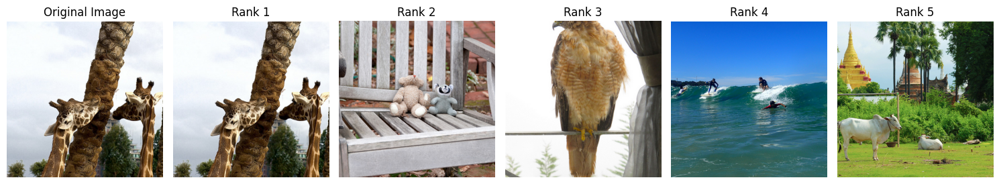

Top-5 Predicted Descriptions:
1. a crowded place
2. a photo of a animal
3. a grassy hill
4. a group of gis
5. a green grassy field
Cosine similarity to true embedding: 74.06%

===== Sample 15 =====


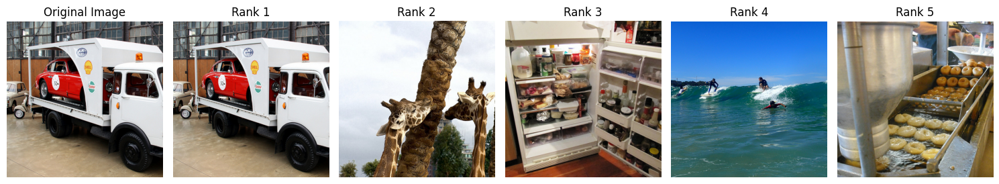

Top-5 Predicted Descriptions:
1. A food factory
2. a group of gis
3. a crowded place
4. a photo of a animal
5. a refrigerator with a lot of food inside of it
Cosine similarity to true embedding: 72.41%

===== Sample 16 =====


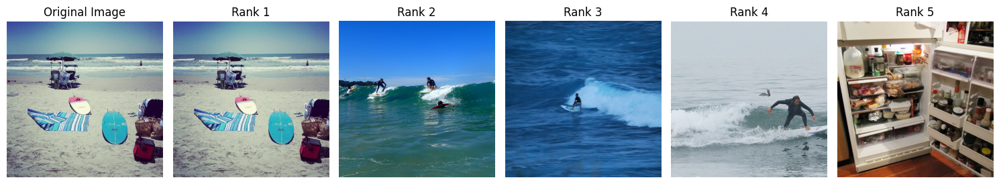

Top-5 Predicted Descriptions:
1. a wave in the ocean
2. a crowded place
3. a clean beach
4. a photo of a animal
5. a group of gis
Cosine similarity to true embedding: 76.74%

===== Sample 17 =====


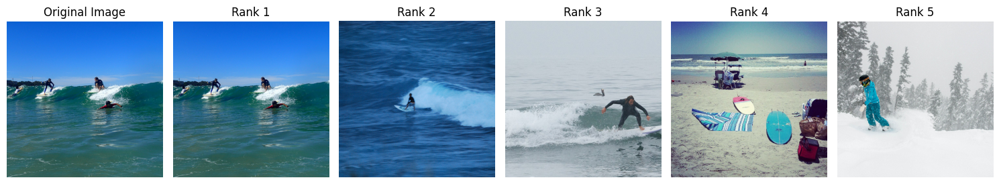

Top-5 Predicted Descriptions:
1. a person on a surf board riding a wave
2. a wave in the ocean
3. a crowded place
4. a group of people surfing in the ocean
5. a beach with a lot of surfboards and chairs
Cosine similarity to true embedding: 78.99%

===== Sample 18 =====


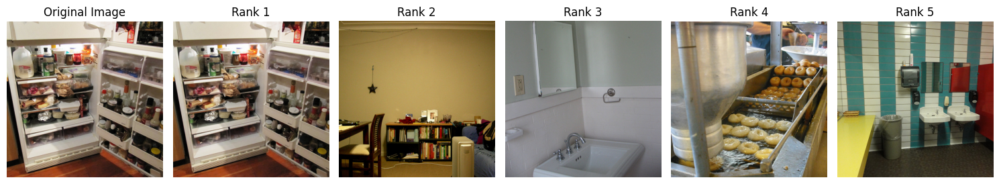

Top-5 Predicted Descriptions:
1. a refrigerator with a lot of food inside of it
2. a col of pictures of various dishes of food
3. a crowded place
4. a photo of a skin disease
5. a apartment
Cosine similarity to true embedding: 80.82%

===== Sample 19 =====


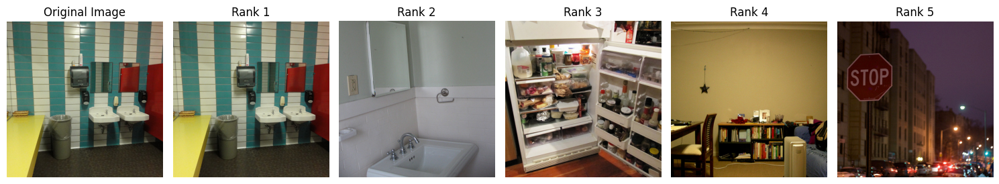

Top-5 Predicted Descriptions:
1. a photo of a bathroom
2. a crowded place
3. A food factory
4. a photo of a animal
5. a white sink with a mirror above it
Cosine similarity to true embedding: 76.52%

===== Sample 20 =====


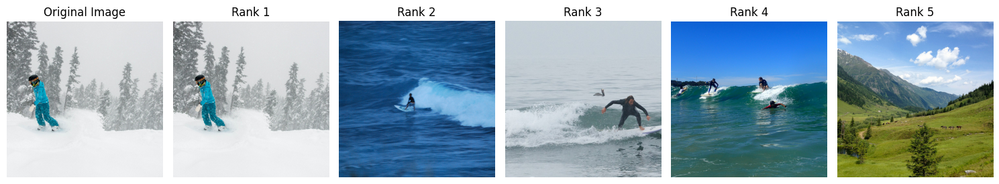

Top-5 Predicted Descriptions:
1. a person on a snowboard
2. a crowded place
3. a grassy hill
4. a photo of a animal
5. a mountain
Cosine similarity to true embedding: 78.07%

===== Sample 21 =====


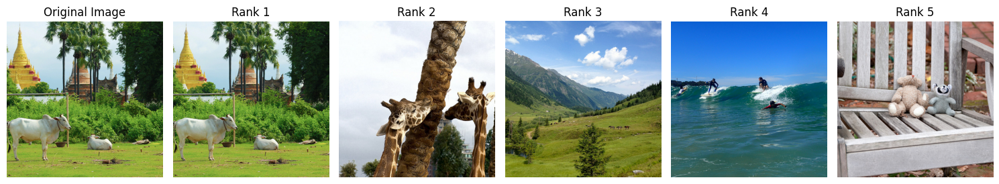

Top-5 Predicted Descriptions:
1. a crowded place
2. a group of gis
3. a photo of a animal
4. a green grassy field
5. a grassy hill
Cosine similarity to true embedding: 76.55%

===== Sample 22 =====


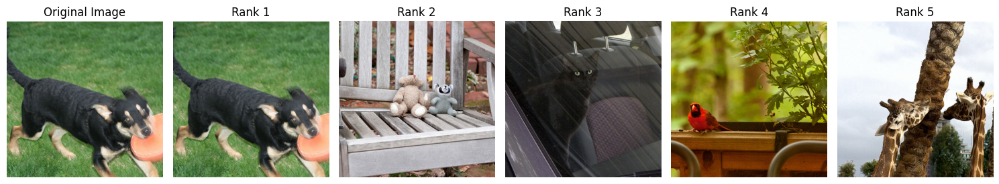

Top-5 Predicted Descriptions:
1. a photo of a animal
2. a dog
3. a dog running in the grass
4. a baby with toys
5. a photo of a cat
Cosine similarity to true embedding: 80.00%

===== Sample 23 =====


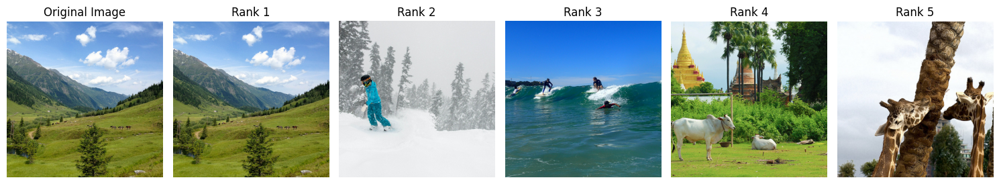

Top-5 Predicted Descriptions:
1. a grassy hill
2. a green grassy field
3. a crowded place
4. a mountain
5. a blue sky
Cosine similarity to true embedding: 76.92%

===== Sample 24 =====


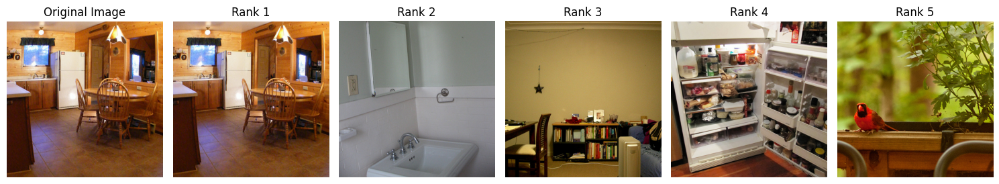

Top-5 Predicted Descriptions:
1. a apartment
2. a kitchen with a table and chairs in it
3. a house
4. a photo of a animal
5. a crowded place
Cosine similarity to true embedding: 78.21%

===== Sample 25 =====


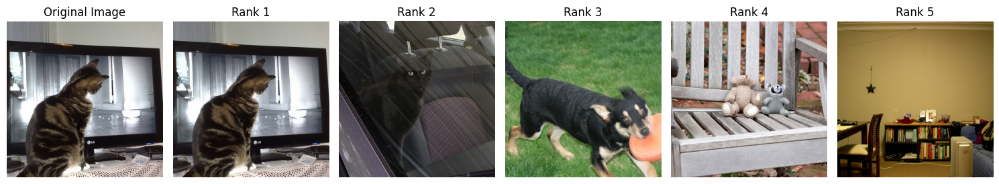

Top-5 Predicted Descriptions:
1. a apartment
2. a crowded place
3. a photo of a cat
4. a grassy hill
5. a man eating food
Cosine similarity to true embedding: 75.12%

===== Sample 26 =====


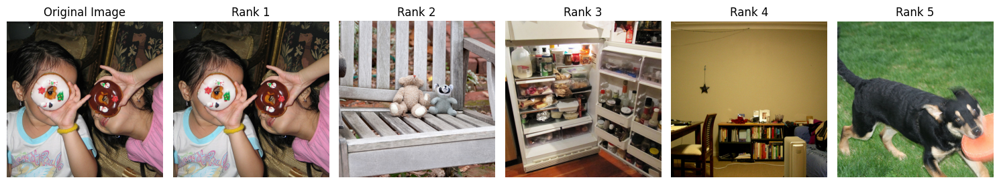

Top-5 Predicted Descriptions:
1. two little girls eating donuts
2. a crowded place
3. A food factory
4. a refrigerator with a lot of food inside of it
5. a col of pictures of various dishes of food
Cosine similarity to true embedding: 74.25%

===== Sample 27 =====


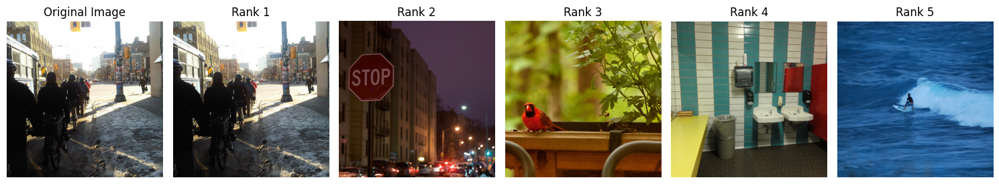

Top-5 Predicted Descriptions:
1. a crowded place
2. a grassy hill
3. a group of gis
4. a group of people riding bikes down a street
5. a group of birds
Cosine similarity to true embedding: 72.42%

===== Sample 28 =====


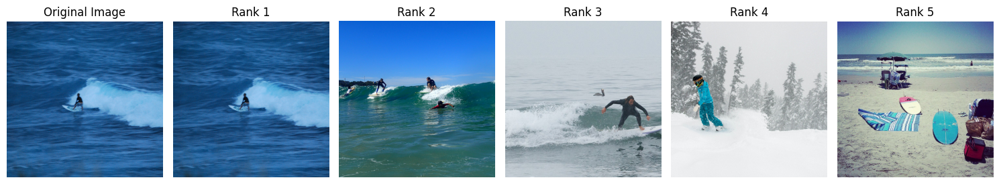

Top-5 Predicted Descriptions:
1. a person on a surf board riding a wave
2. a wave in the ocean
3. a crowded place
4. a photo of a animal
5. a group of people surfing in the ocean
Cosine similarity to true embedding: 79.54%

===== Sample 29 =====


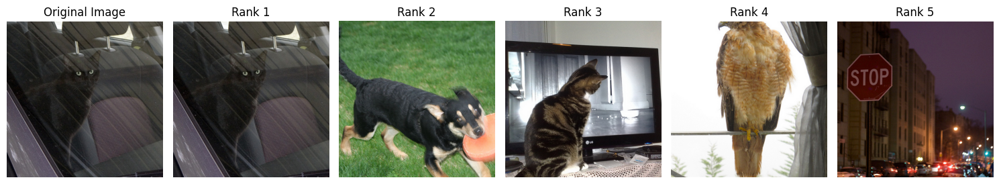

Top-5 Predicted Descriptions:
1. a crowded place
2. a photo of a animal
3. a black cat sitting in the back of a car
4. a photo of a cat
5. a close-up face
Cosine similarity to true embedding: 76.82%

===== Sample 30 =====


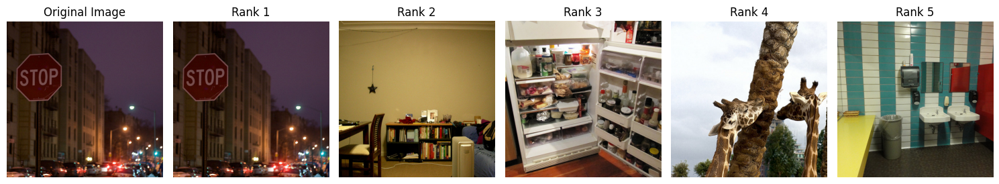

Top-5 Predicted Descriptions:
1. a photo of a animal
2. a stop sign on a city street at night
3. a grassy hill
4. a crowded place
5. a photo of a skin disease
Cosine similarity to true embedding: 75.84%


In [29]:
import torch
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
# from transformers import CLIPProcessor, CLIPModel
from transformers.models.clip.processing_clip import CLIPProcessor
from transformers.models.clip.modeling_clip import CLIPModel
from PIL import Image
import numpy as np

# clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32").to(device)

# Normalize predicted embeddings
predicted_clip = predicted_clip / np.linalg.norm(predicted_clip, axis=1, keepdims=True)

# Normalize ground-truth CLIP embeddings (if not already)
clip_targets = clip_targets / np.linalg.norm(clip_targets, axis=1, keepdims=True)

# --- EVALUATION: Image + Text Retrieval ---
for i in range(len(predicted_clip)):
    print(f"\n===== Sample {i+1} =====")

    # Show actual image (ground truth)
    plt.figure(figsize=(15, 3))
    plt.subplot(1, 6, 1)
    plt.imshow(image_batch[i])
    plt.title("Original Image")
    plt.axis("off")

    # --- IMAGE RETRIEVAL ---
    sim_img = cosine_similarity([predicted_clip[i]], clip_targets)[0]
    top5_img_idx = sim_img.argsort()[::-1][:5]

    for j, idx in enumerate(top5_img_idx):
        plt.subplot(1, 6, j + 2)
        plt.imshow(image_batch[idx])
        plt.title(f"Rank {j+1}")
        plt.axis("off")
    plt.tight_layout()
    plt.show()

    # --- TEXT DESCRIPTION RETRIEVAL ---
    pred_vec = torch.tensor(predicted_clip[i]).unsqueeze(0).to(device)
    pred_vec /= pred_vec.norm(dim=-1, keepdim=True)
    sim_text = torch.matmul(pred_vec, text_features.T).squeeze(0)
    top5_txt_idx = sim_text.topk(5).indices.cpu().numpy()

    print("Top-5 Predicted Descriptions:")
    for rank, idx in enumerate(top5_txt_idx):
        # print(f"{rank+1}. {text_content[idx]} (score: {sim_text[idx] * 100:.2f}%)")
        print(f"{rank+1}. {text_content[idx]}")

    # Optional: Show similarity to true embedding
    sim_to_true = cosine_similarity([predicted_clip[i]], [clip_targets[i]])[0][0]
    print(f"Cosine similarity to true embedding: {sim_to_true * 100:.2f}%")
